<a href="https://colab.research.google.com/github/HenryGohHongTian/Henry1/blob/main/Leaf_blast_disease_detection_using_YOLOV5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Check GPU specification

In [1]:
# Check if NVIDIA is enabled
!nvidia-smi

Mon Nov 28 14:05:44 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Import libraries

In [2]:
import os
import glob as glob
import matplotlib.pyplot as plt #plotting library
import cv2 # computer vision lib
import requests # use to download data from internet
import random
import numpy as np

SEED = 42 # ensure result is reproducable
np.random.seed(SEED) # 

# Check google colab session

In [3]:
# blank colab session
!ls

sample_data


# Hyperparameters and constants

In [4]:
TRAIN = True # To train new model
EPOCHS = 100 # no. of time the data pass through the model

# Download and prepare the dataset

In [5]:

if not os.path.exists('train'):
  !curl -L "https://universe.roboflow.com/ds/pnG9uK4LbD?key=xBI8HwoaDv" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip # with aug

  #!curl -L "https://universe.roboflow.com/ds/E4hPNZmaAX?key=SFbE6MGcPb" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip # wo aug

  dirs = ['train', 'valid', 'test']

  for i, dir_name in enumerate(dirs):
    all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
    for j, image_name in enumerate(all_image_names):
      if (j % 2) == 0:
        file_name = image_name.split('.jpg')[0]
        os.remove(f"{dir_name}/images/{image_name}")
        os.remove(f"{dir_name}/labels/{file_name}.txt")

Streaming output truncated to the last 5000 lines.
 extracting: train/labels/blast__0_4670_jpg.rf.bd4047ff973884a77ff3b70deb0760ce.txt  
 extracting: train/labels/blast__0_4697_jpg.rf.b63365637e1314aace7f2deecf363d2e.txt  
 extracting: train/labels/blast__0_4697_jpg.rf.bd74b23d2e4597a32136f760cb3035a1.txt  
 extracting: train/labels/blast__0_4697_jpg.rf.e215a006141ede4a60b7df22851f7346.txt  
 extracting: train/labels/blast__0_4708_jpg.rf.757f7864d2d9fc2ddfb434c9f5c88ffc.txt  
 extracting: train/labels/blast__0_4708_jpg.rf.a9c364c16c36281535b234403c919220.txt  
 extracting: train/labels/blast__0_4708_jpg.rf.b40e2dfb2c8c3dc6ea5b1a7de010769d.txt  
 extracting: train/labels/blast__0_4711_jpg.rf.07c33bcdcac5c8b892fc535dcebb03ba.txt  
 extracting: train/labels/blast__0_4711_jpg.rf.826a13edc3b305d78bd779430abd2bc4.txt  
 extracting: train/labels/blast__0_4711_jpg.rf.d5698c134864330ba25325e468cdc575.txt  
 extracting: train/labels/blast__0_4730_jpg.rf.e8ab44a287307f30451e43021265c754.txt  
 ex

# Visualize image datasets

In [6]:
class_names = ['Rice Blast', 'Bacterial Blight', 'Brown Spot', 'Sheath Blight', 'Rice Tungro']
colors = np.random.uniform(0, 255, size=(len(class_names), 3)) # 5 colors to repersent the classes

In [7]:
# function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax
def yolo2bbox(bboxes):
  xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
  xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
  return xmin, ymin, xmax, ymax

In [8]:
def plot_box(image, bboxes, labels):
  # Need the image height and width to denormalise
  # the bounding box coordinates
  h, w, _ = image.shape
  for box_num, box in enumerate(bboxes):
    x1, y1, x2, y2 = yolo2bbox(box)
    # denormalize the coordinates
    xmin = int(x1*w)
    ymin = int(y1*h)
    xmax = int(x2*w)
    ymax = int(y2*h)
    width = xmax - xmin
    height = ymax - ymin

    class_name = class_names[int(labels[box_num])]

    # create rectangle, label 

    cv2.rectangle(
        image,
        (xmin, ymin), (xmax, ymax),
        color=colors[class_names.index(class_name)],
        thickness=2
    )

    font_scale = min(1, max(3,int(w/500)))
    font_thickness = min(2, max(10, int(w/50)))

    p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
    tw, th = cv2.getTextSize(
        class_name,
        0, fontScale=font_scale, thickness=font_thickness
    )[0]
    p2 = p1[0] + tw, p1[1] + -th - 10
    cv2.rectangle(
        image,
        p1, p2,
        color=colors[class_names.index(class_name)],
        thickness=-1,
    )
    cv2.putText(
        image, 
        class_name,
        (xmin+1, ymin-10),
        cv2.FONT_HERSHEY_SIMPLEX,
        font_scale,
        (255, 255, 255),
        font_thickness
    )
    return image

In [9]:
# Function to plot images with the bounding boxes
def plot(image_paths, label_paths, num_samples):
  all_training_images = glob.glob(image_paths)
  all_training_labels = glob.glob(label_paths)
  all_training_images.sort()
  all_training_labels.sort()

  num_images = len(all_training_images)

  plt.figure(figsize=(15,12))

  for i in range(num_samples):
    j = random.randint(0, num_images-1)
    image = cv2.imread(all_training_images[j])
    with open(all_training_labels[j], 'r') as f:
      bboxes = []
      labels = []
      label_lines = f.readlines()
      for label_line in label_lines:
        label = label_line[0]
        bbox_string = label_line[2:]
        x_c, y_c, w, h = bbox_string.split(' ')
        x_c = float(x_c)
        y_c = float(y_c)
        w = float(w)
        h = float(h)
        bboxes.append([x_c, y_c, w, h])
        labels.append(label)
    result_image = plot_box(image, bboxes, labels)
    plt.subplot(2, 2, i+1)
    plt.imshow(result_image[:, :, ::-1])
    plt.axis('off')
  plt.subplots_adjust(wspace=0)
  plt.tight_layout()
  plt.show()

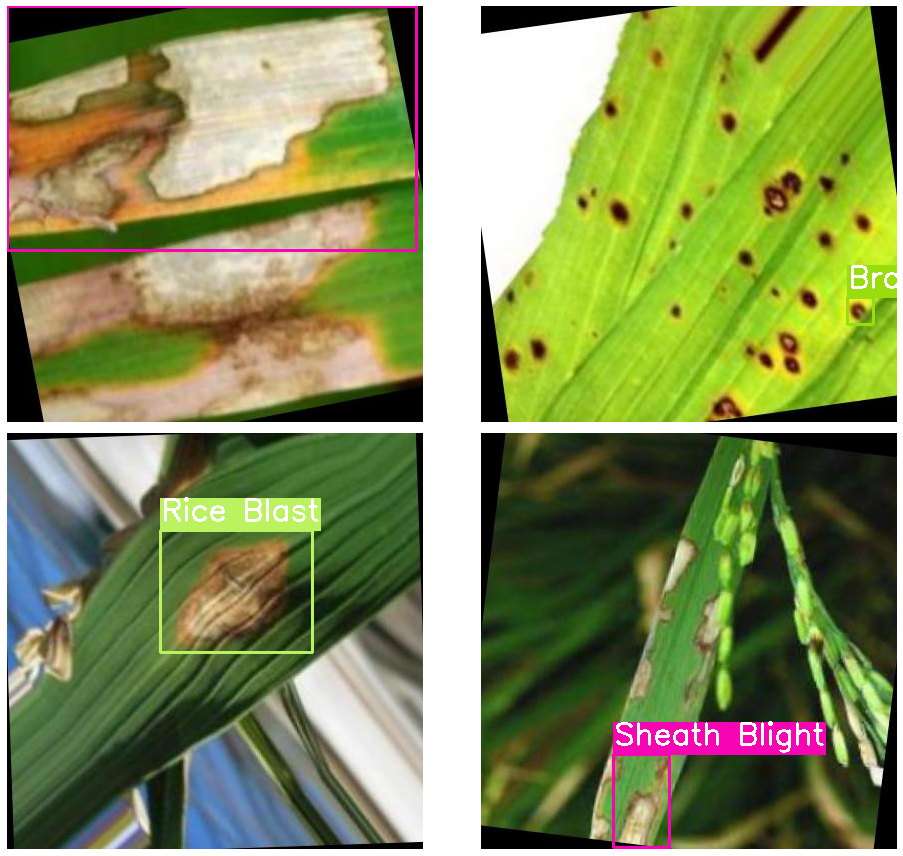

In [10]:
plot(
    image_paths='train/images/*',
    label_paths='train/labels/*',
    num_samples=4,
)

# Helper functions fot logging
- To store the logging of the results in the notebook while training the models.
- A custom result directories is created to keep track the result and carry out inference using the proper model.

In [11]:
def set_res_dir():
  # Directory to store results
  res_dir_count = len(glob.glob('runs/train/*'))
  print(f"Current number of result directories: {res_dir_count}")
  if TRAIN:
    RES_DIR = f"result_{res_dir_count+1}"
    print(RES_DIR)
  else:
    RES_DIR = f"results_{res_dir_count}"
  return RES_DIR

# Function to monitor TensorBoard logs

In [12]:
def monitor_tensorboard():
  %load_ext tensorboard
  %tensorboard --logdir runs/train

# Clone YOLOv5 repository

In [13]:
if not os.path.exists('yolov5'):
  !git clone https://github.com/ultralytics/yolov5  # clone


Cloning into 'yolov5'...
remote: Enumerating objects: 14184, done.
remote: Counting objects: 100% (124/124), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 14184 (delta 76), reused 90 (delta 58), pack-reused 14060
Receiving objects: 100% (14184/14184), 13.60 MiB | 18.67 MiB/s, done.
Resolving deltas: 100% (9739/9739), done.


In [14]:
# YOLOv5 directory
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [15]:
# requirements for YOLOv5
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 182 kB 28.6 MB/s 
     |████████████████████████████████| 62 kB 1.6 MB/s 
     |████████████████████████████████| 1.6 MB 63.3 MB/s 


# Monitor the training process of the model

In [18]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 192), started 2:15:34 ago. (Use '!kill 192' to kill it.)

<IPython.core.display.Javascript object>

# Train small yolov5 model

In [17]:
RES_DIR = set_res_dir()
if TRAIN:
  !python train.py --data ../data.yaml --weights yolov5s.pt \
  --img 640 --epochs {EPOCHS} --batch-size 32 --name {RES_DIR}

Current number of result directories: 0
result_1
train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=result_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-8-g350e8eb Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=

In [25]:
RES_DIR = set_res_dir()

Current number of result directories: 1
result_2


# Visualization and inference utilities

In [26]:
# Function to show validation predictions saved during training
def show_valid_results(RES_DIR):
  !ls runs/train/{RES_DIR}
  EXP_PATH = f"runs/train/{RES_DIR}"
  validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
  print(validation_pred_images)
  for pred_image in validation_pred_images:
    image = cv2.imread(pred_image)
    plt.figure(figsize=(19,16))
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

Helper function for create inference directory and carry out inference on images.

In [27]:
def inference(RES_DIR, data_path):
  # Directory to store inference results
  infer_dir_count = len(glob.glob('runs/detect/*'))
  print(f"Current number of inference detection directories: {infer_dir_count}")
  INFER_DIR = f"inference_{infer_dir_count+1}"
  print(INFER_DIR)
  # Inference on images
  !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
  --source {data_path} --name {INFER_DIR}
  return INFER_DIR

In [28]:
rnd_array = np.random.randint(0, 50, size=140)

  Helper funtion to visualise inference images.

In [29]:
def visualize(INFER_DIR):
  INFER_PATH = f"runs/detect/{INFER_DIR}"
  infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
  for i,pred_image in enumerate(infer_images):
    if i == 140:
      break
    image = cv2.imread(infer_images[rnd_array[i]])
    plt.figure(figsize=(15,6))
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

Visualize validation prediction images.

confusion_matrix.png				   results.png
events.out.tfevents.1669644477.0f2282b67e9f.220.0  train_batch0.jpg
F1_curve.png					   train_batch1.jpg
hyp.yaml					   train_batch2.jpg
labels_correlogram.jpg				   val_batch0_labels.jpg
labels.jpg					   val_batch0_pred.jpg
opt.yaml					   val_batch1_labels.jpg
P_curve.png					   val_batch1_pred.jpg
PR_curve.png					   val_batch2_labels.jpg
R_curve.png					   val_batch2_pred.jpg
results.csv					   weights
['runs/train/result_2/val_batch0_pred.jpg', 'runs/train/result_2/val_batch2_pred.jpg', 'runs/train/result_2/val_batch1_pred.jpg']


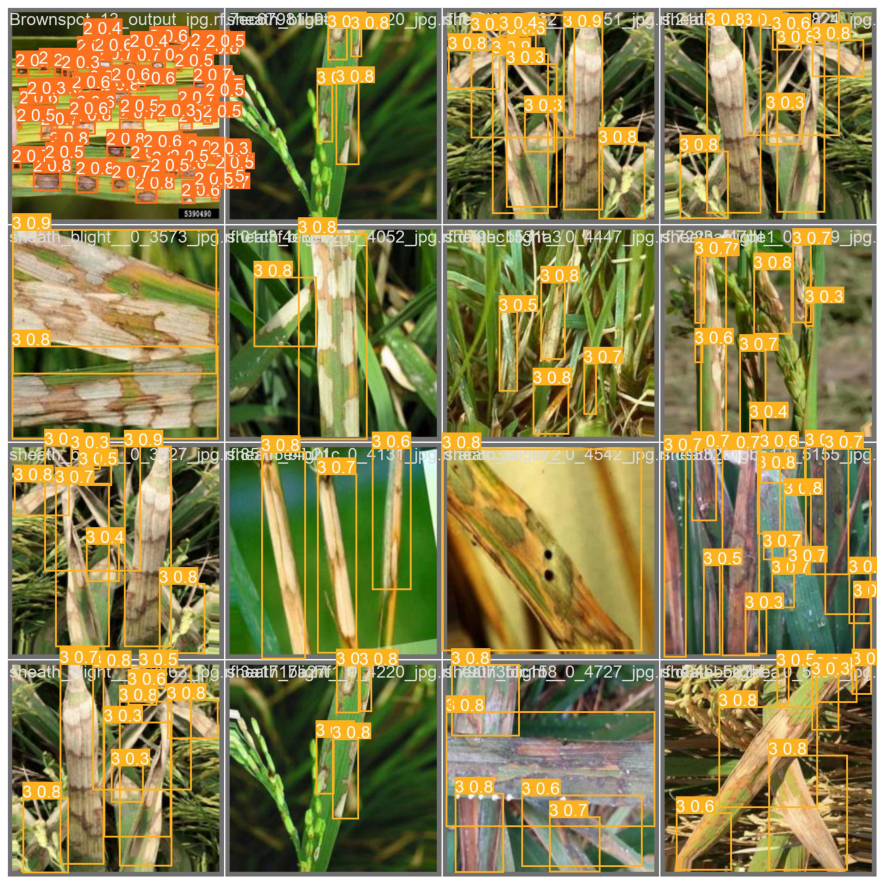

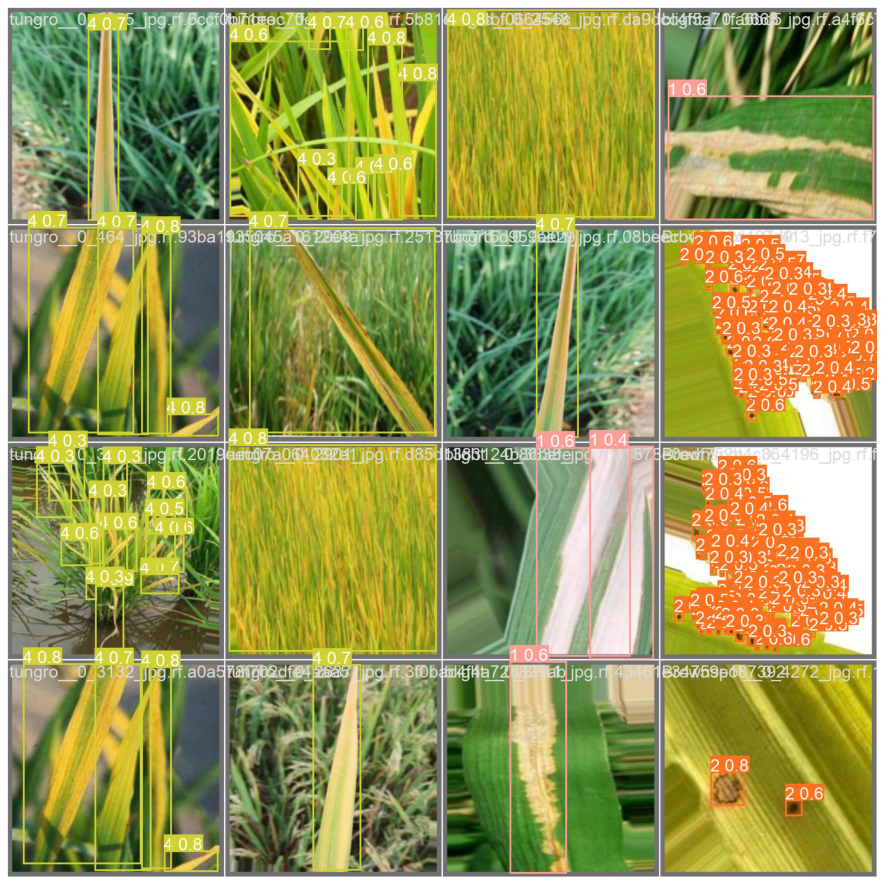

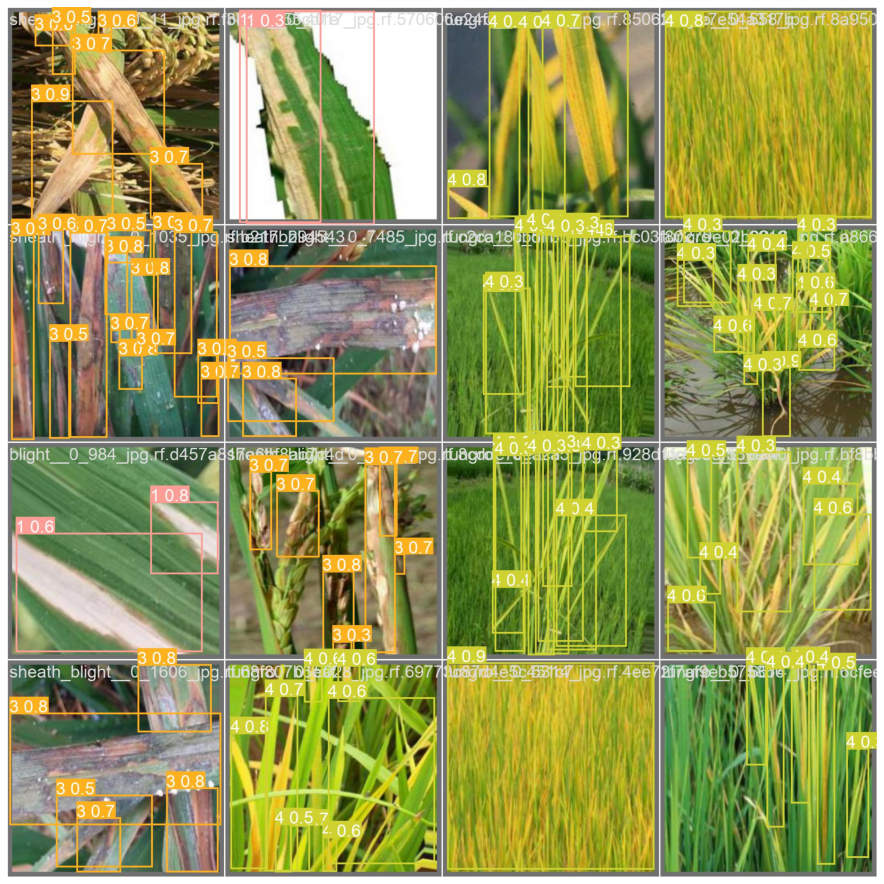

In [30]:
show_valid_results(RES_DIR)

Inference on images.

In [31]:
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/result_2/weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-8-g350e8eb Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/140 /content/test/images/Brownspot_16_output_jpg.rf.dbd12fedbfee097b94dbb3c9240b5b9b.jpg: 640x640 236 2s, 12.7ms
image 2/140 /content/test/images/Brownspot_32_output_jpg.rf.32c23241e508d0fbdbb9973879491dc8.jpg: 640x640 23 2s, 12.7ms
image 3/140 /content/test/images/B

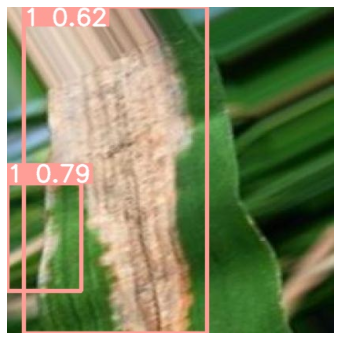

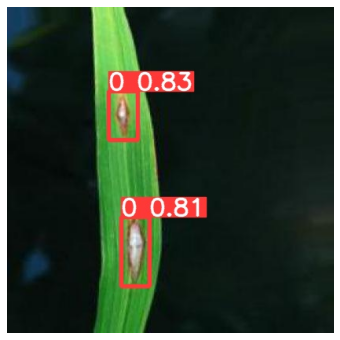

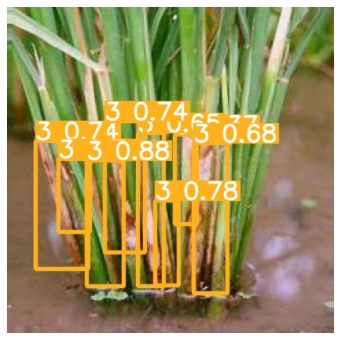

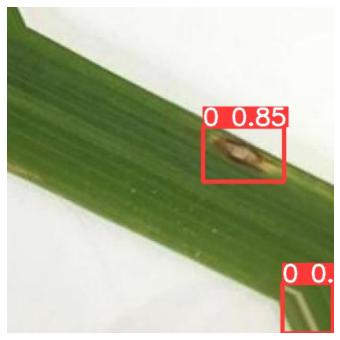

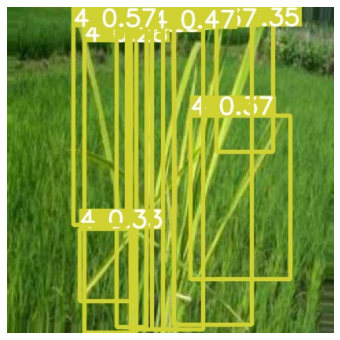

...

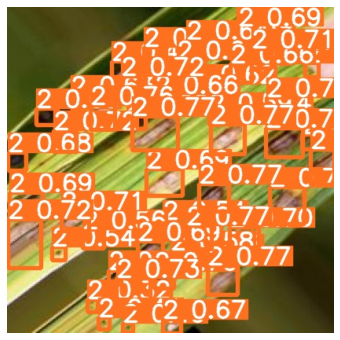

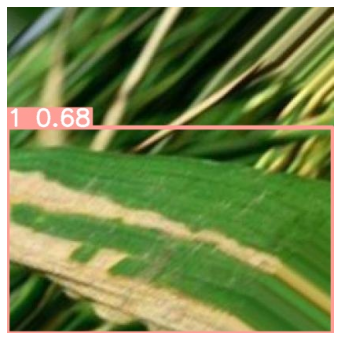

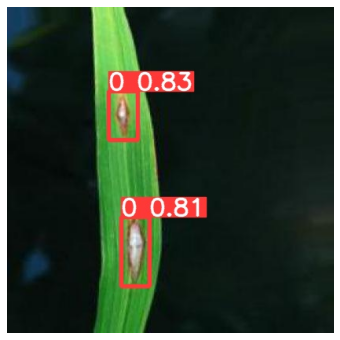

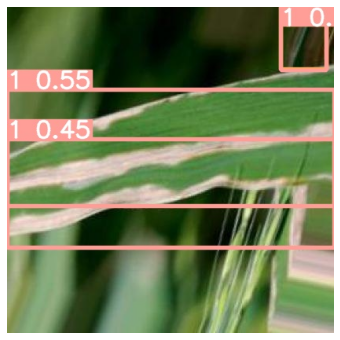

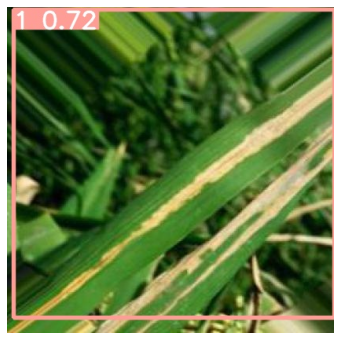

In [32]:
visualize(IMAGE_INFER_DIR)

# Saved model inference



In [33]:
# mount Google drive
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [34]:
# Copy model from google colab to google drive
%cp /content/yolov5/runs/train/result_2/weights/best.pt /content/gdrive/MyDrive/saved_Yolov5s/

In [41]:
# Copy model from google drive to google colab
%cp /content/gdrive/MyDrive/saved_Yolov5s/best.pt /content/yolov5/weights

In [42]:
# Helper function for inference on images using saved model
def inference(RES_DIR, data_path):
  # Directory to store inference results
  infer_dir_count = len(glob.glob('runs/detect/*'))
  print(f"Current number of inference detection directories: {infer_dir_count}")
  INFER_DIR = f"inference_{infer_dir_count+1}"
  print(INFER_DIR)
  # Inference on images
  !python detect.py --weights weights/best.pt \
  --source {data_path} --name {INFER_DIR}
  return INFER_DIR

In [43]:
# Inference on images
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images')

Current number of inference detection directories: 3
inference_4
detect: weights=['weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_4, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-8-g350e8eb Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Traceback (most recent call last):
  File "detect.py", line 259, in <module>
    main(opt)
  File "detect.py", line 254, in main
    run(**vars(opt))
  File "/usr/local/lib/python3.7/dist-packages/torch/autograd/grad_mode.py", line 27, in decorate_context
    return func(*args, **kwargs)
  File "detect.py", line 96, in run
    model = DetectMultiBackend(weights, device=device, dnn=d

In [44]:
# 0 - Rice Blast, 1 - Bacterial Blight, 2 - Brown Spot, 3 - Sheath Blight, 4 - Rice Tungro

visualize(IMAGE_INFER_DIR)